# Inputs and tools

## Imports

In [1]:
import pandas as pd
import numpy as np
from collections import Counter
from sklearn.metrics import confusion_matrix

from scipy.stats import norm
from sklearn.preprocessing import MinMaxScaler


# from fitter import Fitter, get_common_distributions, get_distributions
import random

import seaborn as sns
import matplotlib.pyplot as plt

# Increase the maximum number of rows and columns to be displayed
pd.set_option('display.max_rows', 50)
pd.set_option('display.max_columns', 1000)

## Categorical data distributions

In [2]:
categorical_dists = {
#     'pers_exp':{'labels':['group1', 'group2', 'group3', 'group4'], 'values':[0.10,0.44,0.33,0.14]},
    'sex':{'labels':['M', 'F'], 'values':[0.4854368932,0.5145631068]},
    'lv_educ':{'labels':['Incomplete', 'Primary', 'Basic', 'Secondary', 'Higher'], 'values':[0.0595,0.07788016474,0.2309254283,0.4359496722,0.1957067711]},
    'empl_stat':{'labels':['Employers', 'Self-employed', 'Employed in private sector', 'Employed in public sector', 'Unpaid family workers'], 'values':[0.03631598652,0.07272557095,0.6708785723,0.2126544365,0.00742543367]},
    'marit_stat':{'labels':['Single', 'Married', 'Divorced', 'Widowed'], 'values':[0.397,0.443,0.058,0.102]},
    'house_memb':{'labels':['1', '2', '3', '4', '5', '6', '7+'], 'values':[0.1805,0.3778,0.2387,0.1157,0.0525,0.0238,0.011]},
    'chil_u_18_y':{'labels':['No children under 18', 'One child under 18', 'Two children under 18', 'Three children under 18', 'Four children under 18', 'Five children under 18', 'Six or more children under 18'], 'values':[0.422602157,0.36552047,0.183222339,0.020674764,0.004993779,0.001875149,0.001111341]},
    'nation':{'labels':['Bulgaria', 'EU', 'Other'], 'values':[0.9950198043,0.001146570676,0.003833625045]},
    'religion':{'labels':['Protestant', 'Catholic', 'Orthodox', 'Muslim', 'Other', 'No religion', 'I do not identify myself'], 'values':[0.011,0.008,0.76,0.1,0.002,0.047,0.072]},
    'soc_econ_stat':{'labels':['Economically active', 'Economically inactive'], 'values':[0.6151643031,0.3848356969]},
    'prof_ind':{'labels':['Agriculture, forestry and fisheries', 'Mining and processing industry', 'Utilities (electricity distribution and water supply)', 'Construction', 'Trade, automobile and motorcycle repair', 'Transportation, warehousing and mail', 'Hospitality and restaurant services', 'Creation and distribution of information and creative products, Telecommunications', 'Financial and administrative activities', 'Public administration', 'Education and research', 'Human health and social work', 'Other activities'], 'values':[0.03090815115,0.2353,0.029,0.05523651408,0.1645618594,0.06439111505,0.05161626582,0.03936261795,0.07356911161,0.04836124844,0.104946474,0.06006423384,0.04269692032]},
    'prof_stat':{'labels':['Management contract', 'Employment contract', 'Civil contract', 'Self-employed', 'Unemployed', 'Pensioner'], 'values':[0.01783393631,0.4732428049,0.02497602302,0.0385148509,0.167699009,0.277733376]},
    'count_house':{'labels':['0', '1', '2+'], 'values':[0.37,0.6,0.03]},
    'own_field':{'labels':['YES', 'NO'], 'values':[0.2621335023,0.737866497676384]},
    'num_car_house':{'labels':['0', '1', '2', '3+'], 'values':[0.5714285714,0.36,0.06428571429,0.004285714286]},
    'own_rent_house':{'labels':['my own', 'rented'], 'values':[0.843,0.157]},
    'edu':{'labels':['Educational Sciences', 'Humanities', 'Social, Economic and Legal Sciences', 'Natural Sciences, Mathematics and Informatics', 'Technical Sciences', 'Agricultural Sciences and Veterinary Medicine', 'Health and Sports', 'Arts', 'Security and Defense'], 'values':[0.07591254907,0.0461889827,0.5266633332,0.04571641724,0.1533297557,0.01776640163,0.0930038303,0.02247374859,0.01891291637]},
    'temp':{'labels':['Choleric', 'Phlegmatic', 'Sanguine', 'Melancholic'], 'values':[0.38,0.11,0.23,0.28]},
    'invest_exp':{'labels':['0', '1-5', '6-10', '11-15', '16-25'], 'values':[0.7,0.2,0.06,0.03,0.01]},
    'shares':{'labels':['YES', 'NO'], 'values':[0.003394353314,0.9966056467]},
    'corp_oblig':{'labels':['YES', 'NO'], 'values':[0.0003792213936,0.9996207786]},
    'oth':{'labels':['YES', 'NO'], 'values':[0.000592597502012084,0.999407402497988]},
    'inv_fund':{'labels':['YES', 'NO'], 'values':[0.06491199709,0.9350880029]},
    'cash':{'labels':['YES', 'NO'], 'values':[0.04105169923,0.9589483008]},
    'crypto':{'labels':['YES', 'NO'], 'values':[0.003284135938,0.9967158641]},
    'gov_bond':{'labels':['YES', 'NO'], 'values':[0.06835666691,0.9316433331]},
    'deposits':{'labels':['YES', 'NO'], 'values':[0.8180293286,0.1819706714]},
    'banking':{'labels':['Online', 'Offline'], 'values':[0.09,0.91]},
    'bk_oprat':{'labels':['Up to 7', 'From 8 to 10', 'From 11 to 13', 'From 14 to 18', 'From 19 to more'], 'values':[0.0084,0.2424,0.4729,0.2615,0.0148]},
    'bk_dc':{'labels':['Under one', 'One', 'Two', 'Three'], 'values':[0.01,0.57,0.38,0.04]},
    'bk_cc':{'labels':['YES', 'NO'], 'values':[0.17,0.83]},
    'bk_acc':{'labels':['YES', 'NO'], 'values':[0.8634087377,0.1365912623]},
    'ins_prop':{'labels':['YES', 'NO'], 'values':[0.05,0.95]},
    'ins_life':{'labels':['YES', 'NO'], 'values':[0.09,0.91]},
    'ins_casco':{'labels':['YES', 'NO'], 'values':[0.03,0.97]},
    'health_ins':{'labels':['YES', 'NO'], 'values':[0.02,0.98]},
    'overdraft':{'labels':['YES', 'NO'], 'values':[0.19,0.81]},
    'cons_cred':{'labels':['YES', 'NO'], 'values':[0.26,0.74]},
    'mortgage':{'labels':['YES', 'NO'], 'values':[0.02,0.98]},
    'car_leas':{'labels':['YES', 'NO'], 'values':[0.2,0.8]},
    'pens_ins':{'labels':['YES', 'NO'], 'values':[0.11,0.89]},
    'overdraft_app':{'labels':['YES', 'NO'], 'values':[0.2439,0.7561]},
    'cons_cred_app':{'labels':['YES', 'NO'], 'values':[0.305299502487562,0.694700497512438]},
    'mortgage_app':{'labels':['YES', 'NO'], 'values':[0.03,0.97]},
    'bk_cc_app':{'labels':['YES', 'NO'], 'values':[0.21,0.79]}
}

## Correlation of Numerical data 

In [3]:
corr = {
    'features': ['age', 'ind_risk', 'income', 'pers_exp', 'house_exp', 'taxes', 'transp_telecom', 'hobby'],
    'age': [1, -0.00665947056405372, 0.00291644965339247, 0.0107779942638097, 0.00698674581731255, 0.00729153655132963, 0.0099866509330216, 0.00931630696561133],
    'ind_risk': [-0.00665947056405372, 1, 0.0039918072709289, 0.00806259039194059, 0.00457023635440603, 0.0061985340641631, 0.00768699810849585, -0.00332322616613201],
    'income': [0.00291644965339247, 0.0039918072709289, 1, 0.560949334881676, 0.58892666343229, 0.581907424628933, 0.562946509689962, 0.352350802339294],
    'pers_exp': [0.0107779942638097, 0.00806259039194059, 0.560949334881676, 1, 0.928449923861951, 0.929598634668897, 0.934775947642248, 0.714298364869941],
    'house_exp': [0.00698674581731255, 0.00457023635440603, 0.58892666343229, 0.928449923861951, 1, 0.93031279279417, 0.927846735467478, 0.679286362990223],
    'taxes': [0.00729153655132963, 0.0061985340641631, 0.581907424628933, 0.929598634668897, 0.93031279279417, 1, 0.92920510128812, 0.689442053350162],
    'transp_telecom': [0.0099866509330216, 0.00768699810849585, 0.562946509689962, 0.934775947642248, 0.927846735467478, 0.92920510128812, 1, 0.714114127908189],
    'hobby': [0.00931630696561133, -0.00332322616613201, 0.352350802339294, 0.714298364869941, 0.679286362990223, 0.689442053350162, 0.714114127908189, 1]
}



means = [50.58, 0.6039, 13579.30, 5305.00, 2260, 1500, 1335, 1740]
std = [3]*8      # [3, 3, 3, 3, 3, 3, 3, 3]

# Data Generation (Data synthesis)

## Categorical Data

In [4]:
import numpy as np

# Number of rows in the synthetic dataset
num_rows = 50000

# Create the synthetic dataset
dataset = {}
for key, value_dict in categorical_dists.items():
    labels = value_dict['labels']
    probabilities = value_dict['values']
    
    # Normalize probabilities to ensure they sum to 1
    normalized_probabilities = probabilities / np.sum(probabilities)
    
    sampled_values = np.random.choice(labels, size=num_rows, p=normalized_probabilities)
    dataset[key] = sampled_values

# Printing the first 10 rows of the synthetic dataset
# for key in dataset:
#     print(f"{key}: {dataset[key][:10]}")


In [5]:
cat_df = pd.DataFrame(dataset)

### Perform a Kolmogorov-Smirnov distribution test

In [6]:
def kolmogorov_smirnov_test(categorical_data, old_distributions):
    
    from scipy.stats import ks_2samp
    
#     old = {'sex': {'labels': ['M', 'F'], 'values': [0.4854368932, 0.5145631068]}}
#     new = {'sex': {'labels': ['M', 'F'], 'values': [0.476, 0.524]}}

    statistics = {}
    
    for col in categorical_data:
        
        print()
        print("Reviewed column: ", col)
        # Extract the values for each category in the old and new distributions
        
        
        old_values = old_distributions[col]['values']
        old_labels = old_distributions[col]['labels']
        
        new_data_labels = list(categorical_data[col].value_counts(normalize=True).index)
        
        old_dis_data = []
        new_dis_data = []
        
        
        for i in range(len(old_labels)):
            
            label = old_labels[i]
            old_dis_data.append(old_distributions[col]['values'][i])
            
            new_data_value = categorical_data[col].value_counts(normalize=True)[label]
            new_dis_data.append(new_data_value)
        
        old_dis_data_array = np.array(old_dis_data)
        new_dis_data_array = np.array(new_dis_data)
        
        print(f"old dist: {old_dis_data_array}")
        print(f"new dist: {new_dis_data_array}")
        # Perform the KS test
        ks_statistic, p_value = ks_2samp(old_dis_data_array, new_dis_data_array)

        # Define the significance level (alpha) to test against the p-value
        alpha = 0.05

        # Check if the p-value is less than the significance level
        
        
        if p_value < alpha:
            print(f"Distributions are different for column: {col}, p_value={1-p_value}")
            
            statistics[col] = True
        else:
            print(f"Distributions are similar for column: {col}, p_value={1-p_value}")
            
            statistics[col] = False
    
    print("......................")
    print()
    return statistics

In [7]:
categorical_ks_statistics = kolmogorov_smirnov_test(categorical_data=cat_df,
                                                   old_distributions=categorical_dists)


Reviewed column:  sex
old dist: [0.48543689 0.51456311]
new dist: [0.4811 0.5189]
Distributions are similar for column: sex, p_value=0.0

Reviewed column:  lv_educ
old dist: [0.0595     0.07788016 0.23092543 0.43594967 0.19570677]
new dist: [0.05942 0.07782 0.23266 0.43456 0.19554]
Distributions are similar for column: lv_educ, p_value=0.0

Reviewed column:  empl_stat
old dist: [0.03631599 0.07272557 0.67087857 0.21265444 0.00742543]
new dist: [0.03632 0.07334 0.66846 0.2142  0.00768]
Distributions are similar for column: empl_stat, p_value=0.0

Reviewed column:  marit_stat
old dist: [0.397 0.443 0.058 0.102]
new dist: [0.39794 0.44058 0.05928 0.1022 ]
Distributions are similar for column: marit_stat, p_value=0.0

Reviewed column:  house_memb
old dist: [0.1805 0.3778 0.2387 0.1157 0.0525 0.0238 0.011 ]
new dist: [0.18114 0.3773  0.23796 0.11644 0.05134 0.0245  0.01132]
Distributions are similar for column: house_memb, p_value=3.904623073713864e-05

Reviewed column:  chil_u_18_y
old di

### Save

In [8]:
cat_df.to_csv("df_cat_NoBR_50k.csv")

## Numerical Data

### Generate the correlation matrix of the numerical features

In [9]:
corr.keys()

dict_keys(['features', 'age', 'ind_risk', 'income', 'pers_exp', 'house_exp', 'taxes', 'transp_telecom', 'hobby'])

In [10]:
l_corr_matrix = []

for k, v in corr.items():
    if k == "features":
        continue
    else:
        l_corr_matrix.append(v)

        
arr_corr_matrix = np.array(l_corr_matrix)

In [11]:
print(arr_corr_matrix)

[[ 1.         -0.00665947  0.00291645  0.01077799  0.00698675  0.00729154
   0.00998665  0.00931631]
 [-0.00665947  1.          0.00399181  0.00806259  0.00457024  0.00619853
   0.007687   -0.00332323]
 [ 0.00291645  0.00399181  1.          0.56094933  0.58892666  0.58190742
   0.56294651  0.3523508 ]
 [ 0.01077799  0.00806259  0.56094933  1.          0.92844992  0.92959863
   0.93477595  0.71429836]
 [ 0.00698675  0.00457024  0.58892666  0.92844992  1.          0.93031279
   0.92784674  0.67928636]
 [ 0.00729154  0.00619853  0.58190742  0.92959863  0.93031279  1.
   0.9292051   0.68944205]
 [ 0.00998665  0.007687    0.56294651  0.93477595  0.92784674  0.9292051
   1.          0.71411413]
 [ 0.00931631 -0.00332323  0.3523508   0.71429836  0.67928636  0.68944205
   0.71411413  1.        ]]


### Generate synthetic data (Copula)

In [12]:
feature_bounds = []

# define lower and upper bounds for each numerical feature
possible_values = {
    'age': [20, 86],
    'ind_risk': [0, 1],
    'income': [0, 150000],
    'pers_exp': [0, 6000],
    'house_exp': [0, 4000],
    'taxes': [0, 2500],
    'transp_telecom': [0, 2500],
    'hobby': [0, 3000],
}



for v in possible_values.values():
    
    feature_bounds.append(tuple(v))

In [13]:
feature_bounds

[(20, 86),
 (0, 1),
 (0, 150000),
 (0, 6000),
 (0, 4000),
 (0, 2500),
 (0, 2500),
 (0, 3000)]

In [14]:
def generate_synthetic_data_with_bounds(correlation_matrix, num_samples, feature_bounds, means=means, std=std):
    num_features = correlation_matrix.shape[0]
    lower_bounds, upper_bounds = zip(*feature_bounds)
    scaler = MinMaxScaler(feature_range=(0, 1))
    
    # Check if the correlation matrix is valid (symmetric and positive definite)
    if not np.allclose(correlation_matrix, correlation_matrix.T):
        raise ValueError("Correlation matrix must be symmetric.")
    if not np.all(np.linalg.eigvals(correlation_matrix) > 0):
        raise ValueError("Correlation matrix must be positive definite.")
    
    # Generate synthetic data using multivariate normal distribution
    mean = np.zeros(num_features)
    synthetic_data = np.random.multivariate_normal(mean, correlation_matrix, num_samples)
    
    # Apply Gaussian copula to maintain correlation structure
    synthetic_data = norm.cdf(synthetic_data, loc=mean, scale=std)
    
    # Scale the data to the specified bounds for each feature
    for i in range(num_features):
        synthetic_data[:, i] = lower_bounds[i] + synthetic_data[:, i] * (upper_bounds[i] - lower_bounds[i])
    
    return synthetic_data

# Example usage:
correlation_matrix = np.array(l_corr_matrix)

num_samples = num_rows

synthetic_num_data = generate_synthetic_data_with_bounds(correlation_matrix, num_samples, feature_bounds)
print(synthetic_num_data)

[[5.42209506e+01 6.45830272e-01 8.47955973e+04 ... 1.54166288e+03
  1.48839604e+03 1.82974931e+03]
 [5.90774563e+01 5.89335226e-01 1.08204965e+05 ... 1.33861710e+03
  1.37669782e+03 1.80234150e+03]
 [5.54235658e+01 6.17675063e-01 7.20962636e+04 ... 1.52883129e+03
  1.27192028e+03 1.63902887e+03]
 ...
 [3.69469502e+01 6.81234908e-01 7.18152790e+04 ... 1.60231461e+03
  1.65069128e+03 1.45299256e+03]
 [6.31708649e+01 5.70643298e-01 9.20353510e+04 ... 1.26262216e+03
  1.21618039e+03 1.45047428e+03]
 [5.73043749e+01 5.62411830e-01 9.68717219e+04 ... 1.15550142e+03
  1.11121339e+03 9.52928029e+02]]


In [15]:
import pandas as pd

num_df = pd.DataFrame(synthetic_num_data, columns=possible_values.keys())
num_df

,age,ind_risk,income,pers_exp,house_exp,taxes,transp_telecom,hobby
0,54.220951,0.645830,84795.597260,3588.922615,2484.991017,1541.662884,1488.396042,1829.749305
1,59.077456,0.589335,108204.964543,2980.219877,2314.220374,1338.617101,1376.697817,1802.341496
2,55.423566,0.617675,72096.263613,3046.950479,2313.324058,1528.831285,1271.920281,1639.028867
3,66.191611,0.328559,71060.091217,2986.991040,1679.936256,1274.992163,1122.636516,1235.649596
4,55.764478,0.408784,47330.628161,2040.502939,1441.027844,948.275274,807.686416,1480.276031
...,...,...,...,...,...,...,...,...
49995,58.470247,0.564309,59877.348985,3414.911192,2383.172419,1415.451942,1527.644141,1733.860454
49996,50.278607,0.509734,80694.466785,3034.353255,2282.574818,1314.393769,1506.997071,1735.975759
49997,36.946950,0.681235,71815.278957,3561.898488,2539.988104,1602.314611,1650.691275,1452.992558
49998,63.170865,0.570643,92035.351004,3187.946694,1797.217964,1262.622157,1216.180391,1450.474280


In [16]:
pd.DataFrame(correlation_matrix)

,0,1,2,3,4,5,6,7
0,1.000000,-0.006659,0.002916,0.010778,0.006987,0.007292,0.009987,0.009316
1,-0.006659,1.000000,0.003992,0.008063,0.004570,0.006199,0.007687,-0.003323
2,0.002916,0.003992,1.000000,0.560949,0.588927,0.581907,0.562947,0.352351
3,0.010778,0.008063,0.560949,1.000000,0.928450,0.929599,0.934776,0.714298
4,0.006987,0.004570,0.588927,0.928450,1.000000,0.930313,0.927847,0.679286
5,0.007292,0.006199,0.581907,0.929599,0.930313,1.000000,0.929205,0.689442
6,0.009987,0.007687,0.562947,0.934776,0.927847,0.929205,1.000000,0.714114
7,0.009316,-0.003323,0.352351,0.714298,0.679286,0.689442,0.714114,1.000000


### Plot distributions

In [17]:
import plotly.express as px

def plot_distribution(data, column_name):
    """
    Plots the distribution of a pandas column using Plotly.

    Parameters:
        data (pd.DataFrame): The pandas DataFrame containing the data.
        column_name (str): The name of the column to plot.

    Returns:
        None
    """
    # Ensure the column exists in the DataFrame
    if column_name not in data.columns:
        raise ValueError(f"Column '{column_name}' not found in the DataFrame.")

    # Use Plotly Express to plot the distribution
    fig = px.histogram(data, x=column_name, nbins=50, title=f'Distribution of {column_name}')
    fig.show()


In [18]:
for col in num_df.columns:
    plot_distribution(num_df, col)

### Plot the two correlation matrices

Adjusted Correlation Matrix:
                     age  ind_risk    income  pers_exp  house_exp     taxes  \
age             1.000000 -0.008799  0.007128  0.010066   0.004340  0.005727   
ind_risk       -0.008799  1.000000  0.004297 -0.000798  -0.001649  0.000760   
income          0.007128  0.004297  1.000000  0.558511   0.588141  0.580582   
pers_exp        0.010066 -0.000798  0.558511  1.000000   0.928108  0.928768   
house_exp       0.004340 -0.001649  0.588141  0.928108   1.000000  0.929861   
taxes           0.005727  0.000760  0.580582  0.928768   0.929861  1.000000   
transp_telecom  0.008548  0.000530  0.562392  0.934121   0.928593  0.928681   
hobby           0.008723 -0.012373  0.349187  0.714212   0.680136  0.689151   

                transp_telecom     hobby  
age                   0.008548  0.008723  
ind_risk              0.000530 -0.012373  
income                0.562392  0.349187  
pers_exp              0.934121  0.714212  
house_exp             0.928593  0.680136  
t

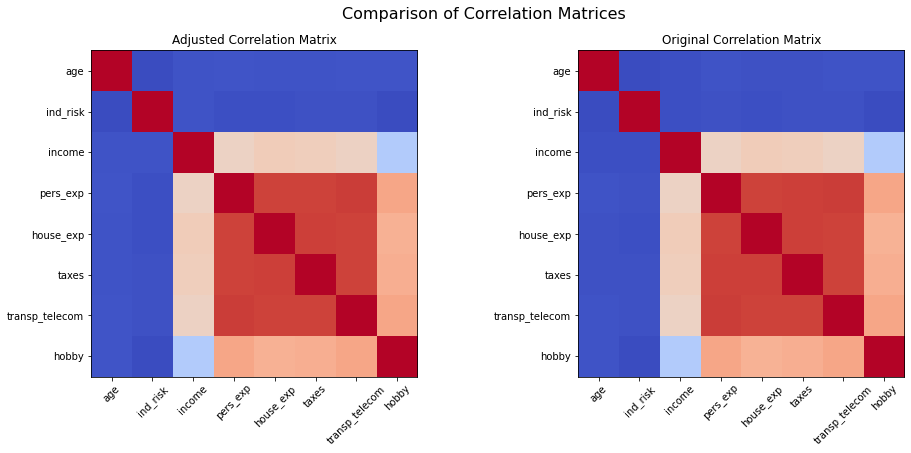

In [19]:
# Calculate the correlation matrix for the adjusted DataFrame
correlation_matrix_adjusted = num_df.corr()


# Display the correlation matrix
print("Adjusted Correlation Matrix:")
print(correlation_matrix_adjusted)

# Convert the original correlation data (corr) to a DataFrame
original_corr_df = pd.DataFrame(corr)
original_corr_df.set_index('features', inplace=True)

# Display the original correlation data
print("\nOriginal Correlation Matrix:")
print(original_corr_df)

# Plot the correlation matrix heatmaps for both adjusted and original data side by side
fig, axes = plt.subplots(1, 2, figsize=(16, 6))
fig.suptitle("Comparison of Correlation Matrices", fontsize=16)

# Adjusted correlation matrix heatmap
axes[0].imshow(correlation_matrix_adjusted, cmap='coolwarm', interpolation='nearest')
axes[0].set_xticks(np.arange(len(correlation_matrix_adjusted)))
axes[0].set_yticks(np.arange(len(correlation_matrix_adjusted)))
axes[0].set_xticklabels(correlation_matrix_adjusted.columns, rotation=45)
axes[0].set_yticklabels(correlation_matrix_adjusted.columns)
axes[0].set_title("Adjusted Correlation Matrix")

# Original correlation matrix heatmap
axes[1].imshow(original_corr_df, cmap='coolwarm', interpolation='nearest')
axes[1].set_xticks(np.arange(len(original_corr_df)))
axes[1].set_yticks(np.arange(len(original_corr_df)))
axes[1].set_xticklabels(original_corr_df.columns, rotation=45)
axes[1].set_yticklabels(original_corr_df.columns)
axes[1].set_title("Original Correlation Matrix")

plt.show()


In [20]:
# Function to measure the distance between two correlation matrices using Frobenius norm
def correlation_distance(matrix1, matrix2):
    return np.linalg.norm(matrix1 - matrix2, ord='fro')


current_distance = correlation_distance(matrix1=correlation_matrix_adjusted, matrix2=original_corr_df)

In [21]:
current_distance

0.025967296634622706

## Save

In [22]:
num_df.to_csv("df_num_NoBR_50k.csv")

## Combine the two datasets

In [ ]:
# import pandas as pd

In [ ]:
# num_df = pd.read_csv("df_num_NoBR_50k.csv", index_col=[0])
# cat_df = pd.read_csv("df_cat_NoBR_50k.csv", index_col=[0])

In [ ]:
# df_merged = pd.concat([cat_df, num_df], axis=1)

In [ ]:
# df_merged.shape